In [1]:
import os
from IPython.display import display
import warnings

import chardet
import regex as re

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import random

warnings.filterwarnings('ignore')
pd.options.display.max_colwidth = 5000
pd.set_option('display.max_rows', None)

### General Functions

In [2]:
'''Exploratory Data Analysis'''

def dim_header(df):
    '''Prints dimension and headers'''
    df.columns = df.columns.str.replace(' ', '_')
    print('Dimension: \n{}\n'.format(df.shape))
    print('Headers: \n{}\n'.format(df.columns))

def completeness(df):
    '''Inspects completeness of data'''
    print(f'\nNull in Counts: \n{df.isnull().sum()}\n')
    print(f'Null in Percentage: \n{df.isnull().sum()/len(df)*100}\n')
    
def uniq_count(df,column):
    '''Inspects categorical values
    and prints counts and fraction of categories'''
    print(f'Column Name: {column}')
    counts = df[column].value_counts()
    print(f'Unique count: {len(counts)}')
    print(f'Total count: {df[column].count()}')
    print(f'In Counts: \n{counts}\n')

def duplicates(df,Column=None):
    print('No. of duplicated rows (last occurence): {}'.format(df.duplicated(subset=Column,keep='last').sum()))
    print('No. of duplicated rows (all duplicates): {}'.format(df.duplicated(subset=Column,keep=False).sum()))

### Data Collection and Pre-processing: Extraction

In [3]:
'''Data Extraction'''

def detect_encode(path):
    '''Returns encoding of file'''
    with open(path, mode = 'rb') as file:
        result = chardet.detect(file.read())
        return result['encoding']

def open_mod(path, encode):
    '''Returns data in file with open function 
    and returns False if not successful'''
    try: 
        with open(path, mode = 'r', encoding = encode) as file:
            data = file.read()
    except Exception as e:
        data = None
    return data

In [3]:
parent_dir = os.getcwd()
print(f'Parent Directory: {parent_dir}')

label_dir = 'trec06p-ai201\labels'
label_path = os.path.join(parent_dir, label_dir)
print(f'Label Directory: {label_path}')

'''Reads file in a location'''
df = pd.read_csv(label_path, sep=' ..', names=['spam','file_location'], engine='python')
df['spam'] = df['spam'].replace({'spam': True, 'ham': False})
df['file_location'] = df['file_location'].str.replace('/','\\')
df['file_location'] = df['file_location'].apply(lambda loc: os.path.join(parent_dir, 'trec06p-ai201' + loc))
df['file_encode'] = df['file_location'].apply(lambda x: detect_encode(x))
df['file_data'] = df.apply(lambda x: open_mod(x['file_location'], x['file_encode']), axis=1)
df['id'] = df['file_location'].apply(lambda x: '_'.join(x.split('\\')[-2:])) # Adds ID for a document

df.head()

Parent Directory: C:\Users\maryn\Desktop\Yr1 Sem1\AI201\Exercises
Label Directory: C:\Users\maryn\Desktop\Yr1 Sem1\AI201\Exercises\trec06p-ai201\labels


,spam,file_location,file_encode,file_data,id
0,False,C:\Users\maryn\Desktop\Yr1 Sem1\AI201\Exercises\trec06p-ai201\data\000\000,ascii,"Received: from rodan.UU.NET by aramis.rutgers.edu (5.59/SMI4.0/RU1.4/3.08) \n\tid AA23563; Mon, 27 Jul 92 22:28:01 EDT\nReceived: from relay2.UU.NET by rodan.UU.NET with SMTP \n\t(5.61/UUNET-mail-drop) id AA06229; Mon, 27 Jul 92 22:27:59 -0400\nReceived: from uunet.uu.net (via LOCALHOST.UU.NET) by relay2.UU.NET with SMTP \n\t(5.61/UUNET-internet-primary) id AA26262; Mon, 27 Jul 92 22:28:08 -0400\nReceived: from sarto.UUCP by uunet.uu.net with UUCP/RMAIL\n\t(queueing-rmail) id 222745.1653; Mon, 27 Jul 1992 22:27:45 EDT\nNewsgroups: soc.religion.christian\nPath: jhpb\nFrom: jhpb@sarto.budd-lake.nj.us (Joseph H. Buehler)\nSubject: new Catholic mailing list now up and running\nMessage-Id: <JHPB.92Jul27221355@sarto.budd-lake.nj.us>\nSender: jhpb@sarto.budd-lake.nj.us (Joseph H Buehler)\nOrganization: none\nDate: Tue, 28 Jul 1992 03:13:55 GMT\nContent-Type: text\nContent-Length: 2745\nApparently-To: <soc-religion-christian>\n\nThe mailing list I queried about a few weeks ago is now up and\nrunning. I have also set up an archive server; see below. The\nfollowing is the official welcome to the list message at the moment.\n\nJoe Buehler\n\n--------------------\n\nThis mailing list is for people who desire serious, orthodox\ndiscussion of the Roman Catholic religion. I assume that it will\ncater mainly to Catholics, but everyone else is welcome, provided they\noperate within the below guidelines. My own interests have a\ndoctrinal bent, but I'm certainly not going to limit this list to just\nthat sort of discussion.\n\nHaving participated in USENET religion groups for about 5 years now,\none of my primary observations about Catholics on the net is that they\ndo not know their religion very well. My hope is that this list might\nhelp remedy this problem to some extent. I would like to make this a\nnet resource available for Catholics who want to know more about their\nreligion.\n\nAs far as moderation policy goes: The Catholic Church is not a\ndemocracy, it's a monarchy subject to a divinely given constitution.\nI don't set the rules in the Church, neither does my parish priest,\nnor does my bishop, nor does the Pope. Everyone has to adhere to the\nway Christ set things up. I think it follows that it's not really\nappropriate for someone to call himself a Catholic and argue with this\nstate of affairs. If you want to be Catholic, it's simple enough, you\nhave to follow the teaching of the Church.\n\nThe moderation policy will reflect this way of thinking: there are\nplenty of other places on the net where Catholic doctrine can be\nfreely attacked! If in doubt, you can always subscribe, and see\nwhether the list is to your taste.\n\nBesides the mailing list, there are a few other things that may be of\ninterest:\n\n- I have set up an archive server that we can put interesting things\nin. (It doesn't have anything in it at the moment except some UNIX\nsoftware useful for such endeavors.) Sorry, guys, but nothing that's\ncopyrighted goes into it!\n\n- I am planning on setting up a quotation server that can email\nperiodic interesting citations from the principal sources of Catholic\ndoctrine. (Not done yet.)\n\n- I have obtained permission from the English language publishers of\nthe Italian Catholic magazine ""30 Days"" to take material from their\nmagazine. I intend to scan some of the more interesting pictures\n(ever seen a Cristero? or St. Pius X?) and put them in the archives,\nand also post extracts from some of the more interesting articles.\n(It's a European magazine, and is of generally higher quality than\nAmerican Catholic material. In my opinion...)\n\nIf you have any questions, would like to subscribe, etc., send email\nto\n\n\tcatholic@sarto.budd-lake.nj.us\n\n\n\n",000_000
1,True,C:\Users\maryn\Desktop\Yr1 Sem1\AI201\Exercises\trec06p-ai201\data\000\001,ascii,"Received: from unknown (HELO grou

In [4]:
'''Stores extracted data as csv in local'''
df.to_csv('df_email_data.csv', escapechar='\\', index=False)

In [4]:
'''Reads extracted data'''
df = pd.read_csv('df_email_data.csv')
df = df.drop(['file_location','file_encode'], axis=1)
cols = list(df.columns)
a, b = cols.index('file_data'), cols.index('id')
cols[b], cols[a] = cols[a], cols[b]
df = df[cols]
df.head()

,spam,id,file_data
0,False,000_000,"Received: from rodan.UU.NET by aramis.rutgers.edu (5.59/SMI4.0/RU1.4/3.08) \n\tid AA23563; Mon, 27 Jul 92 22:28:01 EDT\nReceived: from relay2.UU.NET by rodan.UU.NET with SMTP \n\t(5.61/UUNET-mail-drop) id AA06229; Mon, 27 Jul 92 22:27:59 -0400\nReceived: from uunet.uu.net (via LOCALHOST.UU.NET) by relay2.UU.NET with SMTP \n\t(5.61/UUNET-internet-primary) id AA26262; Mon, 27 Jul 92 22:28:08 -0400\nReceived: from sarto.UUCP by uunet.uu.net with UUCP/RMAIL\n\t(queueing-rmail) id 222745.1653; Mon, 27 Jul 1992 22:27:45 EDT\nNewsgroups: soc.religion.christian\nPath: jhpb\nFrom: jhpb@sarto.budd-lake.nj.us (Joseph H. Buehler)\nSubject: new Catholic mailing list now up and running\nMessage-Id: <JHPB.92Jul27221355@sarto.budd-lake.nj.us>\nSender: jhpb@sarto.budd-lake.nj.us (Joseph H Buehler)\nOrganization: none\nDate: Tue, 28 Jul 1992 03:13:55 GMT\nContent-Type: text\nContent-Length: 2745\nApparently-To: <soc-religion-christian>\n\nThe mailing list I queried about a few weeks ago is now up and\nrunning. I have also set up an archive server; see below. The\nfollowing is the official welcome to the list message at the moment.\n\nJoe Buehler\n\n--------------------\n\nThis mailing list is for people who desire serious, orthodox\ndiscussion of the Roman Catholic religion. I assume that it will\ncater mainly to Catholics, but everyone else is welcome, provided they\noperate within the below guidelines. My own interests have a\ndoctrinal bent, but I'm certainly not going to limit this list to just\nthat sort of discussion.\n\nHaving participated in USENET religion groups for about 5 years now,\none of my primary observations about Catholics on the net is that they\ndo not know their religion very well. My hope is that this list might\nhelp remedy this problem to some extent. I would like to make this a\nnet resource available for Catholics who want to know more about their\nreligion.\n\nAs far as moderation policy goes: The Catholic Church is not a\ndemocracy, it's a monarchy subject to a divinely given constitution.\nI don't set the rules in the Church, neither does my parish priest,\nnor does my bishop, nor does the Pope. Everyone has to adhere to the\nway Christ set things up. I think it follows that it's not really\nappropriate for someone to call himself a Catholic and argue with this\nstate of affairs. If you want to be Catholic, it's simple enough, you\nhave to follow the teaching of the Church.\n\nThe moderation policy will reflect this way of thinking: there are\nplenty of other places on the net where Catholic doctrine can be\nfreely attacked! If in doubt, you can always subscribe, and see\nwhether the list is to your taste.\n\nBesides the mailing list, there are a few other things that may be of\ninterest:\n\n- I have set up an archive server that we can put interesting things\nin. (It doesn't have anything in it at the moment except some UNIX\nsoftware useful for such endeavors.) Sorry, guys, but nothing that's\ncopyrighted goes into it!\n\n- I am planning on setting up a quotation server that can email\nperiodic interesting citations from the principal sources of Catholic\ndoctrine. (Not done yet.)\n\n- I have obtained permission from the English language publishers of\nthe Italian Catholic magazine ""30 Days"" to take material from their\nmagazine. I intend to scan some of the more interesting pictures\n(ever seen a Cristero? or St. Pius X?) and put them in the archives,\nand also post extracts from some of the more interesting articles.\n(It's a European magazine, and is of generally higher quality than\nAmerican Catholic material. In my opinion...)\n\nIf you have any questions, would like to subscribe, etc., send email\nto\n\n\tcatholic@sarto.budd-lake.nj.us\n\n\n\n"
1,True,000_001,"Received: from unknown (HELO groucho.cs.psu.edu) ([222.135.252.194]) by groucho.cs.psu.edu\n\twith SMTP id <2533>; Sat, 3 Apr 1993 14:35:34 -0400\nReceived: from auditor \n by content-guys.com with SMTP id LRJ1GB0

In [5]:
'''Exploratory data analysis of extracted data'''
dim_header(df)
df.info()
completeness(df)
uniq_count(df, 'spam')
duplicates(df)

Dimension: 
(37822, 3)

Headers: 
Index(['spam', 'id', 'file_data'], dtype='object')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 37822 entries, 0 to 37821
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   spam       37822 non-null  bool  
 1   id         37822 non-null  object
 2   file_data  37547 non-null  object
dtypes: bool(1), object(2)
memory usage: 628.0+ KB

Null in Counts: 
spam           0
id             0
file_data    275
dtype: int64

Null in Percentage: 
spam         0.00000
id           0.00000
file_data    0.72709
dtype: float64

Column Name: spam
Unique count: 2
Total count: 37822
In Counts: 
True     24912
False    12910
Name: spam, dtype: int64

No. of duplicated rows (last occurence): 0
No. of duplicated rows (all duplicates): 0


In [6]:
'''275 files failed to be extracted because of unknown encoder.
   These files are removed.'''
df.dropna(subset=['file_data'], inplace=True)
dim_header(df)
completeness(df)
uniq_count(df, 'spam')
duplicates(df)

Dimension: 
(37547, 3)

Headers: 
Index(['spam', 'id', 'file_data'], dtype='object')


Null in Counts: 
spam         0
id           0
file_data    0
dtype: int64

Null in Percentage: 
spam         0.0
id           0.0
file_data    0.0
dtype: float64

Column Name: spam
Unique count: 2
Total count: 37547
In Counts: 
True     24647
False    12900
Name: spam, dtype: int64

No. of duplicated rows (last occurence): 0
No. of duplicated rows (all duplicates): 0


### Data Collection & Pre-processing: Parsing & Splitting

In [7]:
'''Parser Function'''
def simple_parse(data):
    
    '''a word is a sequence of alphabetic characters [a-zA-Z] delimited by 
       a white space in front and a white space, comma, or period at the end'''
    
    data = re.findall(r'(?<=\s)[a-zA-Z]+(?=[\s,.])', data)
    data = set(word.lower() for word in data)
    
    return data

In [8]:
'''Sample Parse'''
sentence = '/This is An an an AN experiment, for? the <br> /n 1 SIMPLE par+se function.'
print(simple_parse(sentence))

{'is', 'an', 'function', 'the', 'simple', 'experiment'}


In [9]:
'''String Parse'''
df['file_data'] = df['file_data'].apply(lambda x: simple_parse(x))
df.head()

,spam,id,file_data
0,False,000_000,"{else, guys, edt, official, groups, etc, extent, constitution, hope, really, goes, running, setting, does, except, sources, archive, than, who, below, primary, neither, at, priest, whether, obtained, far, planning, will, italian, scan, moment, bishop, citations, policy, simple, sarto, some, can, endeavors, h, orthodox, an, questions, if, also, places, serious, their, rules, following, interests, quality, call, resource, into, extracts, operate, such, one, anything, welcome, would, weeks, own, principal, about, we, having, problem, democracy, moderation, soc, uunet, limit, just, christ, generally, or, nothing, guidelines, text, bent, software, tue, reflect, doubt, freely, smtp, going, intend, has, magazine, from, st, argue, on, copyrighted, but, doctrinal, ...}"
1,True,000_001,"{daytona, panerai, apr, sat, watches, philippe, lowest, own, audemars, prices, auditor, shipping, unknown, iwc, buy, lange, men, our, groucho, luxury, only, visit, id, rolex, breitling, delivery, for, smtp, vacheron, tag, bvlgari, patek, omega, your, from, sohne, gold, with, worldwide, fast, heuer, in, piguet, officine, a, full, frank, the, constantin, world, shop, cartier, muller, by}"
2,True,000_002,"{register, after, job, groucho, get, no, hours, receive, career, because, moment, uni, microsoft, produced, qualifications, turned, call, apr, express, academic, redited, just, time, ahead, tue, mas, smtp, webmail, explore, from, but, in, have, prestige, you, ifications, helors, by, down, letters, within, do, dreams, normal, wed, lack, and, take, of, are, message, a, to, ph, the, days, qual, confidentiality, experience, getting, clean, mimeole, prestigious, right, bac, versities, deserve, knowledge, id, for, outlook, again, your, ters, with, that, outbound, this, day, move, available}"
3,False,000_003,"{fri, bob, apr, eric, verify, gibson, groucho, is, tony, and, take, first, id, who, s, siebenmann, changes, are, smtp, hunt, members, up, scott, schwartz, your, from, politics, on, rdist, localhost, with, chris, krohn, due, before, john, greetings, subscription, to, a, takes, local, effect, this, list, the, w, noel, it, y, charter, sloane, day, signed, all, by}"
4,True,000_004,"{what, seek, opt, elsewhere, groucho, get, confidential, no, at, mime, continued, mortgage, luscious, states, will, action, interest, card, least, plus, loan, can, cash, turned, if, service, following, loans, sender, apr, free, campaign, we, must, our, bills, just, or, only, smtp, low, obligation, from, conferred, pool, in, even, fast, have, available, apache, home, extra, devmail, you, info, by, down, sat, within, chauncey, us, rates, is, and, take, of, age, help, current, use, be, out, tonsillitis, set, message, format, kept, united, may, last, a, to, the, credit, complete, others, all, jailyn, try, esmtp, fri, new, information, years, id, for, lower, not, include, ...}"


In [10]:
'''Randomize and Test-Train Split'''
df = df.sample(frac=1).reset_index(drop=True) #Randomizes dataframe
df_train = df.sample(frac=0.7)
df_test = df.drop(df_train.index)
print('TRAIN DATASET')
display(df_train.head())
print('TEST DATASET')
display(df_test.head())

TRAIN DATASET


,spam,id,file_data
8171,True,025_063,"{invest, said, amount, oral, money, which, signify, concerning, point, transactions, thousand, over, believing, goes, good, forfeited, management, national, fact, written, contributions, who, no, at, receive, operated, single, because, states, accomodate, will, dollars, remain, interest, then, industrialist, was, onward, apply, before, microsoft, can, reliability, through, an, based, intact, purpose, if, also, another, crucial, into, enable, necessary, proved, kin, one, anything, once, confidence, pending, sold, express, about, immigrationdepartment, must, remitted, next, customer, released, present, claims, our, chang, nature, or, aleve, nothing, only, contact, conclusion, hear, ahead, tue, intend, empty, kuala, honest, has, from, he, existing, added, on, abroad, risk, hunred, position, assurance, ...}"
29918,True,057_149,"{rosalie, esmtp, nov, visa, store, confidence, us, sell, big, bbb, prices, we, do, good, med, our, thats, great, and, aleve, only, id, be, out, at, tue, for, are, online, not, verifed, from, meds, with, fit, plus, website, a, to, can, check, the, approved, you, shopping, mon, quality, uid, by}"
15999,False,084_192,"{letting, old, nov, face, along, what, hostname, goes, good, configuration, primary, same, cabled, number, will, steven, need, sun, console, before, until, can, reconfigured, based, agreed, turned, plugged, if, following, call, left, fax, once, address, boot, we, gilfoyle, next, tartan, changed, sjames, master, serial, only, james, time, nw, count, slaves, director, smtp, original, has, cluster, from, secondary, usually, sasko, on, st, but, comes, in, have, am, lengthy, ones, let, please, detect, you, i, argyle, ucontrol, bringing, mon, appropriate, ip, nodes, procedure, by, values, down, required, now, rest, someone, memory, each, do, direct, between, stafanovski, turn, is, and, of, penny, be, are, ...}"
35342,False,071_014,"{letter, anybodyi, after, x, quick, constant, respond, together, hydrogen, at, fixed, needs, regardless, need, timing, two, how, lasts, an, if, record, reaction, campaign, offset, next, present, aug, time, interval, block, from, on, in, have, am, against, series, putting, you, by, letters, display, each, mail, wed, ascii, of, and, responses, window, set, are, earth, there, a, to, want, list, pm, the, they, it, question, esmtp, html, deimos, stupidity, so, id, for, trials, experiment, response, ribbon, dummy, wait, with, had, previous, that, things, this}"
1538,True,105_095,"{esmtp, direitos, ver, uma, de, mail, userid, voce, dias, reservados, aug, id, carregando, at, for, charges, os, hoje, from, charge, localhost, with, animada, quem, deathgrab, clique, port, a, para, sabe, mon, recebeu, na, abaixo, imagem, by}"


TEST DATASET


,spam,id,file_data
2,False,073_137,"{jcf, x, running, phobos, no, number, updated, will, if, also, call, correct, one, campaign, called, lists, greater, text, alphabetical, feedback, going, from, on, have, variant, go, thu, pausing, against, custom, error, allow, by, now, continuous, value, mail, acoustic, is, ascii, of, and, help, every, counter, are, up, dmdx, basically, branch, there, last, a, like, keywords, to, list, the, they, it, type, well, subroutine, complete, file, esmtp, random, html, new, request, wrong, during, something, so, id, for, lower, oct, response, everything, ribbon, with, web, c, when, things, page, rate}"
3,True,003_029,"{from, id, with, sun, express, jul, zingg, smtp, outlook, dhksjdhkakfdksgo, normal, microsoft, by}"
4,True,062_122,"{esmtp, from, aleve, feb, id, with, for, mon, media, by}"
8,False,108_245,"{else, said, care, nov, what, anybodyi, x, quick, hope, really, together, isi, get, smtpgate, at, possible, because, will, causing, then, sequential, need, second, sun, before, button, two, how, can, combinations, trial, if, scrambling, repsond, incorrect, into, record, correct, one, once, would, campaign, we, corect, problem, next, reponse, program, complicated, just, only, time, stimulus, item, several, stab, feedback, going, he, from, while, on, but, problems, in, short, have, am, preparing, against, counting, you, i, per, followed, clockon, duration, pair, shown, by, five, stimuli, someone, sequentially, blessings, programe, each, split, mail, is, frame, ascii, of, and, instruction, without, undersatnd, help, be, use, ...}"
13,True,053_041,"{china, caffeine, after, product, opt, good, sep, aid, week, at, mime, hours, will, grows, sun, least, some, hungry, microsoft, world, organic, weight, ephedra, campaign, we, combination, having, spending, humans, our, or, aleve, only, time, body, erskine, side, has, pounds, from, in, adverse, company, have, writely, per, currently, info, by, effects, sat, now, do, fall, is, lose, and, millions, of, stock, without, out, message, format, being, optimally, shallow, may, centuries, proprietary, loss, a, to, safely, people, legal, known, newman, the, zero, it, comprise, esmtp, designed, best, swear, any, right, neuroanatomy, literally, id, for, gym, off, your, ever, with, herb, been, long, ...}"


In [11]:
'''Exploratory Data Analysis of Train and Test Dataset'''

'''Stores extracted data as csv in local'''
df_train.to_csv('df_email_train.csv', escapechar='\\', index=False)
df_test.to_csv('df_email_test.csv', escapechar='\\', index=False)

print('TRAIN DATASET')
dim_header(df_train)
uniq_count(df_train, 'spam')

print('TEST DATASET')
dim_header(df_test)
uniq_count(df_test, 'spam')

TRAIN DATASET
Dimension: 
(26283, 3)

Headers: 
Index(['spam', 'id', 'file_data'], dtype='object')

Column Name: spam
Unique count: 2
Total count: 26283
In Counts: 
True     17198
False     9085
Name: spam, dtype: int64

TEST DATASET
Dimension: 
(11264, 3)

Headers: 
Index(['spam', 'id', 'file_data'], dtype='object')

Column Name: spam
Unique count: 2
Total count: 11264
In Counts: 
True     7449
False    3815
Name: spam, dtype: int64



### Data Collection & Pre-processing: Vocabulary and Prior Probabilities

In [12]:
'''Spam Filter Input: Prior Probabilities'''
prior_spam = df_train['spam'].mean() 
prior_ham = 1 - prior_spam 
dict_prior_prb = {'prior_spam': prior_spam, 'prior_ham': prior_ham}
print("Prior Probability of Spam:")
print(dict_prior_prb["prior_spam"])
print("Prior Probability of Ham:")
print(dict_prior_prb["prior_ham"])

Prior Probability of Spam:
0.6543393067762432
Prior Probability of Ham:
0.3456606932237568


In [13]:
'''List of String Split'''
df_train = df_train.set_index(['id','spam']).apply(lambda x: x.explode()).reset_index()
df_train.dropna(subset=['file_data'], inplace=True)
df_train.head()

,id,spam,file_data
0,025_063,True,invest
1,025_063,True,said
2,025_063,True,amount
3,025_063,True,oral
4,025_063,True,money


In [14]:
'''Spam Filter Input: Vocabulary--union of words in ham dataset and words in spam dataset'''
set_voc_all = set(df_train['file_data'])
print(f'Vocabulary Size: {len(set_voc_all)}')
print(f'VOCABULARY: \n{set_voc_all}')

Vocabulary Size: 73230
VOCABULARY: 
{'indict', 'glueck', 'nieves', 'austenite', 'vowing', 'chem', 'extremities', 'entrances', 'eople', 'nuking', 'mtawmcaxmdawidewmdagmtawmcaxmdawidewmdagmtawmcaxmdawidewmdagmtawmcanmtawmcax', 'cacheos', 'arguably', 'researching', 'bushman', 'thousandfold', 'propellant', 'deprivation', 'ought', 'sleeping', 'lovell', 'vingnir', 'icagicagicagicagicagicagicagicagicagicagicagicagicagciagicagicagicagicagicag', 'libguilereadline', 'bannere', 'loyalmail', 'morley', 'minima', 'investsource', 'repugnant', 'reno', 'unlikse', 'insufficiency', 'murderous', 'dorthy', 'rue', 'describled', 'dampen', 'rfdamy', 'payloads', 'coattecflex', 'diurnal', 'initally', 'dains', 'genealogy', 'synchronously', 'mike', 'aaaaaaaaaaaaaaaaaaaaaaaaawaaacgaaiaoaaaaqaaagbaaaabyaacaaaaaaaaaaaaaaaaa', 'reached', 'beraber', 'cosmosphere', 'abdoul', 'manifests', 'lubiw', 'rtement', 'sofuluskajad', 'bandgap', 'automatisering', 'troups', 'boffinsoft', 'paraphase', 'foote', 'aachen', 'mimimizer',

In [15]:
'''Exploratory data analysis of exploded train dataset'''
dim_header(df_train)
df_train.info()
completeness(df_train)
uniq_count(df_train, 'spam')
duplicates(df_train)

Dimension: 
(2418345, 3)

Headers: 
Index(['id', 'spam', 'file_data'], dtype='object')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2418345 entries, 0 to 2418344
Data columns (total 3 columns):
 #   Column     Dtype 
---  ------     ----- 
 0   id         object
 1   spam       bool  
 2   file_data  object
dtypes: bool(1), object(2)
memory usage: 39.2+ MB

Null in Counts: 
id           0
spam         0
file_data    0
dtype: int64

Null in Percentage: 
id           0.0
spam         0.0
file_data    0.0
dtype: float64

Column Name: spam
Unique count: 2
Total count: 2418345
In Counts: 
True     1266458
False    1151887
Name: spam, dtype: int64

No. of duplicated rows (last occurence): 0
No. of duplicated rows (all duplicates): 0


### Data Collection and Pre-processing: Dictionary of Conditional Probabilities

In [17]:
def naive_bayes_input(df_train, set_voc, dict_prior_prb, lambda_=0):
    
    prior_spam = dict_prior_prb['prior_spam']
    prior_ham = dict_prior_prb['prior_ham']
    
    '''Spam-Ham Split'''
    df_train_spam = df_train[df_train['spam'] == True]
    df_train_ham = df_train[df_train['spam'] == False]

    '''Compute how many documents have the specific word (count)'''
    df_train_spam_prb = df_train_spam.groupby('file_data').size().reset_index(name='count')
    df_train_spam_prb = df_train_spam_prb.sort_values('count', ascending=False) 
    
    df_train_ham_prb = df_train_ham.groupby('file_data').size().reset_index(name='count') 
    df_train_ham_prb = df_train_ham_prb.sort_values('count', ascending=False) 

    '''Vocabulary'''
    set_voc_all = set(df_train['file_data']) 
    set_voc_ham = set(df_train_ham_prb['file_data']) 
    set_voc_spam = set(df_train_spam_prb['file_data']) 
    
    vocabulary_cnt = len(set_voc)
    
    '''Dictionary of Spam Conditional Probabilities'''
    # Conditional probabilities for words in spam dataset
    train_spam_id_cnt = df_train_spam['id'].nunique() 
    train_spam_prb_denominator = train_spam_id_cnt + lambda_ * vocabulary_cnt 
    df_train_spam_prb['probability'] = (df_train_spam_prb['count'] + lambda_) / train_spam_prb_denominator
    df_train_spam_prb = df_train_spam_prb[['file_data', 'probability']]

    # Conditional probabilities for words not in spam but in ham (spam_zero)
    spam_zero = lambda_ / train_spam_prb_denominator # conditional probability for word not in spam but in ham
    train_spam_others = [word for word in set_voc_all if word not in set_voc_spam]
    df_train_spam_prb_others = pd.DataFrame({'file_data': train_spam_others,
                                            'probability': spam_zero})
    
    df_train_spam_prb_fin = pd.concat([df_train_spam_prb, df_train_spam_prb_others], ignore_index=True)   
    
    # Masking if vocabulary is not union of words in ham dataset and words in spam dataset
    mask_voc_spam = df_train_spam_prb_fin['file_data'].isin(set_voc)
    df_train_spam_prb_fin = df_train_spam_prb_fin[mask_voc_spam]
    
    # Final dictionary of conditional probabilities of words for ham condition
    dict_train_spam = dict(df_train_spam_prb_fin.values) 
    
    '''Dictionary of Ham Conditional Probabilities'''
    # Conditional probabilities for words in ham dataset
    train_ham_id_cnt = df_train_ham['id'].nunique() 
    train_ham_prb_denominator = train_ham_id_cnt + lambda_ * vocabulary_cnt 
    df_train_ham_prb['probability'] = (df_train_ham_prb['count'] + lambda_) / train_ham_prb_denominator
    df_train_ham_prb = df_train_ham_prb[['file_data', 'probability']]
    
    # Conditional probabilities for words not in ham but in spam (ham_zero)
    ham_zero = lambda_ / train_ham_prb_denominator # conditional probability for word not in ham but in spam
    train_ham_others = [word for word in set_voc_all if word not in set_voc_ham]
    df_train_ham_prb_others = pd.DataFrame({'file_data': train_ham_others,
                                            'probability': ham_zero})
    
    df_train_ham_prb_fin = pd.concat([df_train_ham_prb, df_train_ham_prb_others], ignore_index=True)
    
    # Masking if vocabulary is not union of words in spam dataset and words in ham dataset
    mask_voc_ham = df_train_ham_prb_fin['file_data'].isin(set_voc)
    df_train_ham_prb_fin = df_train_ham_prb_fin[mask_voc_ham]
    
    # Final dictionary of conditional probabilities of words for spam condition
    dict_train_ham = dict(df_train_ham_prb_fin.values) 

    return dict_train_spam, dict_train_ham, spam_zero, ham_zero

In [18]:
'''Varying Lambda, Same Prior Probabilities, Same Vocabulary of Union of Ham and Spam'''

l = 0.0
dict_train_spam_00, dict_train_ham_00, spam_zero_00, ham_zero_00 = naive_bayes_input(df_train, set_voc_all, dict_prior_prb, lambda_=l)
l = 2.0
dict_train_spam_20, dict_train_ham_20, spam_zero_20, ham_zero_20 = naive_bayes_input(df_train, set_voc_all, dict_prior_prb, lambda_=l)
l = 1.0
dict_train_spam_10, dict_train_ham_10, spam_zero_10, ham_zero_10 = naive_bayes_input(df_train, set_voc_all, dict_prior_prb, lambda_=l)
l = 0.5
dict_train_spam_05, dict_train_ham_05, spam_zero_05, ham_zero_05 = naive_bayes_input(df_train, set_voc_all, dict_prior_prb, lambda_=l)
l = 0.1
dict_train_spam_01, dict_train_ham_01, spam_zero_01, ham_zero_01 = naive_bayes_input(df_train, set_voc_all, dict_prior_prb, lambda_=l)
l = 0.005
dict_train_spam_0005, dict_train_ham_0005, spam_zero_0005, ham_zero_0005 = naive_bayes_input(df_train, set_voc_all, dict_prior_prb, lambda_=l)

In [19]:
print(f'lambda = 0.0: Spam Dictionary Size = {len(dict_train_spam_00)}, Ham Dictionary Size = {len(dict_train_ham_00)}')
print(f'lambda = 2.0: Spam Dictionary Size = {len(dict_train_spam_20)}, Ham Dictionary Size = {len(dict_train_ham_20)}')
print(f'lambda = 1.0: Spam Dictionary Size = {len(dict_train_spam_10)}, Ham Dictionary Size = {len(dict_train_ham_10)}')
print(f'lambda = 0.5: Spam Dictionary Size = {len(dict_train_spam_05)}, Ham Dictionary Size = {len(dict_train_ham_05)}')
print(f'lambda = 0.1: Spam Dictionary Size = {len(dict_train_spam_01)}, Ham Dictionary Size = {len(dict_train_ham_01)}')
print(f'lambda = 0.005: Spam Dictionary Size = {len(dict_train_spam_0005)}, Ham Dictionary Size = {len(dict_train_ham_0005)}')

lambda = 0.0: Spam Dictionary Size = 73230, Ham Dictionary Size = 73230
lambda = 2.0: Spam Dictionary Size = 73230, Ham Dictionary Size = 73230
lambda = 1.0: Spam Dictionary Size = 73230, Ham Dictionary Size = 73230
lambda = 0.5: Spam Dictionary Size = 73230, Ham Dictionary Size = 73230
lambda = 0.1: Spam Dictionary Size = 73230, Ham Dictionary Size = 73230
lambda = 0.005: Spam Dictionary Size = 73230, Ham Dictionary Size = 73230


In [20]:
print('LAMBDA = 0.0, SPAM DICTIONARY')
print(dict_train_spam_00)

LAMBDA = 0.0, SPAM DICTIONARY
{'with': 1.0, 'from': 1.0, 'by': 1.0, 'id': 0.9986044888940574, 'for': 0.9471450168624259, 'esmtp': 0.8356785672752646, 'a': 0.6322246772880568, 'in': 0.6161762995697174, 'is': 0.5871612978253286, 'to': 0.569368531224561, 'this': 0.5397720665193627, 'the': 0.5143621351319921, 'and': 0.503895801837423, 'of': 0.45266891499011513, 'you': 0.4308059076636818, 'aleve': 0.4062100244214443, 'message': 0.3974880800093034, 'our': 0.3735899523200372, 'format': 0.36876380974531925, 'mime': 0.36864751715315736, 'your': 0.36835678567275265, 'microsoft': 0.3572508431212932, 'smtp': 0.3544016746133271, 'at': 0.306372834050471, 'outlook': 0.27846261193162, 'it': 0.26904291196650776, 'that': 0.26212350273287593, 'on': 0.26113501569949993, 'we': 0.2549715083149203, 'will': 0.2512501453657402, 'be': 0.2471217583439935, 'have': 0.24601697871845563, 'mimeole': 0.242760786137923, 'produced': 0.2424119083614374, 'or': 0.24008605651819978, 'all': 0.23962088614955226, 'normal': 0.2

In [21]:
print('LAMBDA = 0.0, HAM DICTIONARY')
print(dict_train_ham_00)

LAMBDA = 0.0, HAM DICTIONARY
{'by': 1.0, 'from': 0.9986791414419373, 'with': 0.9962575674188222, 'id': 0.9962575674188222, 'for': 0.9784259768849752, 'the': 0.9212988442487617, 'to': 0.882883874518437, 'a': 0.8351128233351679, 'esmtp': 0.8351128233351679, 'and': 0.7950467804072647, 'of': 0.7897633461750138, 'is': 0.7565217391304347, 'in': 0.7246009906439186, 'i': 0.7167859108420473, 'on': 0.6512933406714364, 'that': 0.6204733076499724, 'it': 0.6200330214639516, 'this': 0.580737479361585, 'you': 0.5767749036873968, 'be': 0.5674188222344524, 'have': 0.5620253164556962, 'smtp': 0.5120528343423225, 'at': 0.505558613098514, 'if': 0.47385800770500824, 'are': 0.46505228398459, 'not': 0.4561364887176665, 'can': 0.44479911942762795, 'but': 0.44204733076499725, 'or': 0.4317006053935058, 'list': 0.41386901485965877, 'as': 0.4130985140341222, 'aleve': 0.40176114474408364, 'an': 0.38822234452394055, 'any': 0.35443037974683544, 'will': 0.35167859108420474, 'my': 0.33241607044578975, 'all': 0.3307649

In [22]:
print('LAMBDA = 2.0, SPAM DICTIONARY')
print(dict_train_spam_20)

LAMBDA = 2.0, SPAM DICTIONARY
{'with': 0.10509721492380451, 'from': 0.10509721492380451, 'by': 0.10509721492380451, 'id': 0.10495056764716665, 'for': 0.09954294932114531, 'esmtp': 0.0878294980996957, 'a': 0.06644954722653339, 'in': 0.06476310354519792, 'is': 0.06171406225176893, 'to': 0.059844309474636134, 'this': 0.05673416514927471, 'the': 0.05406396265382688, 'and': 0.05296410807904288, 'of': 0.04758093096579452, 'you': 0.04528345696513461, 'aleve': 0.04269879871439221, 'message': 0.04178225323540554, 'our': 0.03927091862298207, 'format': 0.03876376345794278, 'mime': 0.0387515428515563, 'your': 0.03872099133559007, 'microsoft': 0.03755392342568038, 'smtp': 0.03725451856921141, 'at': 0.03220740813159149, 'outlook': 0.029274462598834153, 'it': 0.028284593481528553, 'that': 0.027557467401532466, 'on': 0.02745359224724731, 'we': 0.026805900108763398, 'will': 0.026414840704395752, 'be': 0.025981009177675395, 'have': 0.02586491341700375, 'mimeole': 0.025522736438182064, 'produced': 0.0254

In [23]:
print('LAMBDA = 2.0, HAM DICTIONARY')
print(dict_train_ham_20)

LAMBDA = 2.0, HAM DICTIONARY
{'by': 0.05842039281236941, 'from': 0.05834324472017744, 'with': 0.05820180655115883, 'id': 0.05820180655115883, 'for': 0.05716030730656723, 'the': 0.053823652319264524, 'to': 0.05157992863801472, 'a': 0.04878973930373847, 'esmtp': 0.04878973930373847, 'and': 0.046449580507248706, 'of': 0.046140988138480825, 'is': 0.04419942781831624, 'in': 0.04233501559034363, 'i': 0.041878556044874476, 'on': 0.03805329647368929, 'that': 0.03625317432254332, 'it': 0.03622745829181266, 'this': 0.033932302549101546, 'you': 0.033700858272525634, 'be': 0.03315439261949918, 'have': 0.032839371243048636, 'smtp': 0.029920601755119097, 'at': 0.02954129030184191, 'if': 0.027689736089234626, 'are': 0.027175415474621493, 'not': 0.026654665852325694, 'can': 0.025992478061011282, 'but': 0.02583175286894468, 'or': 0.025227426146774246, 'list': 0.024185926902182648, 'as': 0.024140923848403998, 'aleve': 0.023478736057089587, 'an': 0.022687968112121894, 'any': 0.020714262753543992, 'will':

In [24]:
print('LAMBDA = 1.0, SPAM DICTIONARY')
print(dict_train_spam_10)

LAMBDA = 1.0, SPAM DICTIONARY
{'with': 0.19019551466359977, 'from': 0.19019551466359977, 'by': 0.19019551466359977, 'id': 0.1899301101428761, 'for': 0.18014331844119078, 'esmtp': 0.15894413234838767, 'a': 0.12025036493121599, 'in': 0.1171982129428938, 'is': 0.11168001061618082, 'to': 0.10829610297695404, 'this': 0.10266731543327288, 'the': 0.09783474145176273, 'and': 0.0958442075463352, 'of': 0.08610164993143717, 'you': 0.08194364577343301, 'aleve': 0.07726589109567833, 'message': 0.0756071128411554, 'our': 0.07106206042376255, 'format': 0.07014420312292653, 'mime': 0.0701220860795329, 'your': 0.07006679347104879, 'microsoft': 0.06795461582695625, 'smtp': 0.06741274826381209, 'at': 0.05827840934223913, 'outlook': 0.052970318927765735, 'it': 0.05117883841288096, 'that': 0.049862874330959435, 'on': 0.049674879462113505, 'we': 0.04850267616225063, 'will': 0.047794930773654175, 'be': 0.047009775733179986, 'have': 0.04679966382094042, 'mimeole': 0.04618038660591852, 'produced': 0.0461140354

In [25]:
print('LAMBDA = 1.0, HAM DICTIONARY')
print(dict_train_ham_10)

LAMBDA = 1.0, HAM DICTIONARY
{'by': 0.11038085403632387, 'from': 0.1102350725870133, 'with': 0.10996780659661058, 'id': 0.10996780659661058, 'for': 0.10799975703091781, 'the': 0.10169470934823543, 'to': 0.09745489886411954, 'a': 0.09218246978072041, 'esmtp': 0.09218246978072041, 'and': 0.08776043248496629, 'of': 0.08717730668772398, 'is': 0.08350847354674118, 'in': 0.07998542185506895, 'i': 0.07912288161331471, 'on': 0.07189455141833202, 'that': 0.06849298426775192, 'it': 0.06844439045131508, 'this': 0.06410739233432546, 'you': 0.06367004798639374, 'be': 0.06263742938711049, 'have': 0.062042155135758975, 'smtp': 0.05652675697017555, 'at': 0.055809998177731884, 'if': 0.052311243394278076, 'are': 0.05133936706554091, 'not': 0.050355342282694525, 'can': 0.049104051509445426, 'but': 0.048800340156715055, 'or': 0.047658385470448886, 'list': 0.04569033590475612, 'as': 0.04560529672599162, 'aleve': 0.04435400595274251, 'an': 0.042859746097309116, 'any': 0.03913017068578024, 'will': 0.03882645

In [26]:
print('LAMBDA = 0.5, SPAM DICTIONARY')
print(dict_train_spam_05)

LAMBDA = 0.5, SPAM DICTIONARY
{'with': 0.3195974950290822, 'from': 0.3195974950290822, 'by': 0.3195974950290822, 'id': 0.3191515061416386, 'for': 0.3027056659171576, 'esmtp': 0.26708230353260365, 'a': 0.20206084031739543, 'in': 0.19693196811179456, 'is': 0.18765911582703065, 'to': 0.18197275751212533, 'this': 0.17251407652425993, 'the': 0.16439336219872522, 'and': 0.16104844554289854, 'of': 0.14467693679965807, 'you': 0.13768977756304238, 'aleve': 0.12982922342184974, 'message': 0.12704179287532752, 'our': 0.11940423317785666, 'format': 0.11786185494211436, 'mime': 0.11782468920149407, 'your': 0.11773177484994332, 'microsoft': 0.11418244662070504, 'smtp': 0.11327188597550777, 'at': 0.09792243509932544, 'outlook': 0.08900265735045435, 'it': 0.08599223236021036, 'that': 0.08378087079330274, 'on': 0.08346496199803022, 'we': 0.08149517774515452, 'will': 0.08030587404530504, 'be': 0.07898649025328452, 'have': 0.07863341571739171, 'mimeole': 0.07759277498002341, 'produced': 0.077481277758162

In [27]:
print('LAMBDA = 0.5, HAM DICTIONARY')
print(dict_train_ham_05)

LAMBDA = 0.5, HAM DICTIONARY
{'by': 0.1988074398249453, 'from': 0.19854485776805253, 'with': 0.19806345733041575, 'id': 0.19806345733041575, 'for': 0.19451859956236323, 'the': 0.18316192560175054, 'to': 0.17552516411378555, 'a': 0.1660284463894967, 'esmtp': 0.1660284463894967, 'and': 0.15806345733041577, 'of': 0.15701312910284465, 'is': 0.15040481400437636, 'in': 0.14405908096280087, 'i': 0.1425054704595186, 'on': 0.12948577680525164, 'that': 0.12335886214442013, 'it': 0.12327133479212254, 'this': 0.11545951859956237, 'you': 0.11467177242888403, 'be': 0.11281181619256017, 'have': 0.11173960612691466, 'smtp': 0.10180525164113785, 'at': 0.10051422319474836, 'if': 0.09421225382932166, 'are': 0.0924617067833698, 'not': 0.09068927789934354, 'can': 0.08843544857768053, 'but': 0.08788840262582057, 'or': 0.08583150984682714, 'list': 0.08228665207877461, 'as': 0.08213347921225383, 'aleve': 0.0798796498905908, 'an': 0.07718818380743983, 'any': 0.07047045951859957, 'will': 0.0699234135667396, 'my

In [28]:
print('LAMBDA = 0.1, SPAM DICTIONARY')
print(dict_train_spam_01)

LAMBDA = 0.1, SPAM DICTIONARY
{'with': 0.7013620977937277, 'from': 0.7013620977937277, 'by': 0.7013620977937277, 'id': 0.7003833448880551, 'for': 0.6642918314913747, 'esmtp': 0.5861139431507687, 'a': 0.4434199257779047, 'in': 0.4321642673626688, 'is': 0.41181436319889075, 'to': 0.39933526365156397, 'this': 0.378577545777089, 'the': 0.36075608661963215, 'and': 0.353415439827087, 'of': 0.3174870519146854, 'you': 0.3021532563924799, 'aleve': 0.2849027364299988, 'message': 0.2787855307695445, 'our': 0.2620243872598997, 'format': 0.25863953346111496, 'mime': 0.25855797071897557, 'your': 0.25835406386362714, 'microsoft': 0.2505648219893153, 'smtp': 0.24856653480690022, 'at': 0.21488112230333184, 'outlook': 0.1953060641898781, 'it': 0.18869948207658743, 'that': 0.1838464989192937, 'on': 0.18315321561110887, 'we': 0.17883039027772116, 'will': 0.17622038252926064, 'be': 0.17332490518331228, 'have': 0.17255005913298807, 'mimeole': 0.17026630235308512, 'produced': 0.17002161412666694, 'or': 0.168

In [29]:
print('LAMBDA = 0.1, HAM DICTIONARY')
print(dict_train_ham_01)

LAMBDA = 0.1, HAM DICTIONARY
{'by': 0.5536994149195514, 'from': 0.5529680643588494, 'with': 0.5516272549975622, 'id': 0.5516272549975622, 'for': 0.5417540224280839, 'the': 0.5101231106777182, 'to': 0.4888529985372989, 'a': 0.4624024865919064, 'esmtp': 0.4624024865919064, 'and': 0.4402181862506095, 'of': 0.4372927840078011, 'is': 0.4188871282301317, 'in': 0.40121282301316435, 'i': 0.3968856655290103, 'on': 0.360622866894198, 'that': 0.3435580204778157, 'it': 0.3433142369575817, 'this': 0.32155655777669434, 'you': 0.31936250609458805, 'be': 0.31418210628961485, 'have': 0.31119575816674794, 'smtp': 0.2835263286201853, 'at': 0.2799305216967333, 'if': 0.262378108239883, 'are': 0.2575024378352024, 'not': 0.2525658215504632, 'can': 0.24628839590443685, 'but': 0.24476474890297414, 'or': 0.2390358361774744, 'list': 0.2291626036079961, 'as': 0.22873598244758653, 'aleve': 0.2224585568015602, 'an': 0.2149622135543637, 'any': 0.19625182837640176, 'will': 0.19472818137493905, 'my': 0.184062652364700

In [30]:
print('LAMBDA = 0.005, SPAM DICTIONARY')
print(dict_train_spam_0005)

LAMBDA = 0.005, SPAM DICTIONARY
{'with': 0.9791538446210035, 'from': 0.9791538446210035, 'by': 0.9791538446210035, 'id': 0.9777874249536698, 'for': 0.9274006997207379, 'esmtp': 0.818257928792455, 'a': 0.6190453281257561, 'in': 0.6033315019514179, 'is': 0.5749213597014372, 'to': 0.557499508942932, 'this': 0.5285200251648955, 'the': 0.5036398003888601, 'and': 0.4933916528838571, 'of': 0.4432326642621476, 'you': 0.42182542280725227, 'aleve': 0.397742276170495, 'message': 0.38920215324965907, 'our': 0.3658022164465687, 'format': 0.36107668176370616, 'mime': 0.360962813458095, 'your': 0.36067814269406717, 'microsoft': 0.34980371950820277, 'smtp': 0.3470139460207297, 'at': 0.2999863358033266, 'outlook': 0.27265794245665176, 'it': 0.26343460970214894, 'that': 0.2566594455182858, 'on': 0.2556915649205911, 'we': 0.24965654472320037, 'will': 0.24601275894364372, 'be': 0.24197043409444804, 'have': 0.24088868519114218, 'mimeole': 0.2377003726340301, 'produced': 0.23735876771719666, 'or': 0.2350814

In [31]:
print('LAMBDA = 0.005, HAM DICTIONARY')
print(dict_train_ham_0005)

LAMBDA = 0.005, HAM DICTIONARY
{'by': 0.9612592118419451, 'from': 0.959989525084249, 'with': 0.9576617660284726, 'id': 0.9576617660284726, 'for': 0.9405209947995746, 'the': 0.885607042529216, 'to': 0.8486803193262196, 'a': 0.8027599815895421, 'esmtp': 0.8027599815895421, 'and': 0.7642461499394254, 'of': 0.7591674029086408, 'is': 0.7272136195066209, 'in': 0.6965295228622972, 'i': 0.6890172095459283, 'on': 0.6260619078101607, 'that': 0.5964358834639171, 'it': 0.5960126545446851, 'this': 0.5582394735032246, 'you': 0.5544304132301361, 'be': 0.545436798696455, 'have': 0.5402522444358623, 'smtp': 0.49221576210302453, 'at': 0.4859731355443518, 'if': 0.45550065335964407, 'are': 0.4470360749750031, 'not': 0.438465689360554, 'can': 0.4275675446903287, 'but': 0.4249223639451284, 'or': 0.4149764843431752, 'list': 0.3978357131142771, 'as': 0.39709506250562104, 'aleve': 0.3861969178353957, 'an': 0.37318262856901013, 'any': 0.3406998090179502, 'will': 0.3380546282727499, 'my': 0.31953836305634764, 'a

### Naive Bayes Classifier

In [33]:
def naive_bayes_classifier(data_test, 
                           dict_train_spam, dict_train_ham, 
                           spam_zero, ham_zero, 
                           prior_spam, prior_ham,
                           set_voc, lambda_=0):

    set_data_test = set(data_test)
    
    '''If word is in test dataset and in vocabulary, add (value in dictionary) to list
       If word is in test dataset and not in vocabulary, add (ham_zero/spam_zero) to list'''
    prob_test_spam = [dict_train_spam.get(word, spam_zero) for word in set_data_test]
    prob_test_ham = [dict_train_ham.get(word, ham_zero) for word in set_data_test]
    
    '''If word is not in test data set and in vocabulary, add (1 - value in dictionary) to list'''
    set_not_in_data_test = set_voc  - set_data_test
    prob_test_spam += [1 - dict_train_spam.get(word, 0) for word in set_not_in_data_test]
    prob_test_ham += [1 - dict_train_ham.get(word, 0) for word in set_not_in_data_test]
    
    '''Naive Bayes Formula'''
    scr_spam = np.exp(np.sum(np.log(prob_test_spam)) + np.log(prior_spam))
    scr_ham = np.exp(np.sum(np.log(prob_test_ham)) + np.log(prior_ham))
    probability = scr_spam / (scr_spam + scr_ham)
    
    '''Return True (Spam) or False (Ham)'''
    if probability > 0.5:
        return True
    elif probability == 0.5:
        return random.choice([True, False])
    else:
        return False

In [34]:
l = 0.0
df_predict_00 = df_test['file_data'].apply(lambda t: naive_bayes_classifier(t, 
                                                                            dict_train_spam_00, dict_train_ham_00, 
                                                                            spam_zero_00, ham_zero_00, 
                                                                            prior_spam, prior_ham, 
                                                                            set_voc_all, lambda_=l))

In [35]:
l = 2.0
df_predict_20 = df_test['file_data'].apply(lambda t: naive_bayes_classifier(t, 
                                                                            dict_train_spam_20, dict_train_ham_20, 
                                                                            spam_zero_20, ham_zero_20, 
                                                                            prior_spam, prior_ham, 
                                                                            set_voc_all, lambda_=l))

In [36]:
l = 1.0
df_predict_10 = df_test['file_data'].apply(lambda t: naive_bayes_classifier(t, 
                                                                            dict_train_spam_10, dict_train_ham_10, 
                                                                            spam_zero_10, ham_zero_10, 
                                                                            prior_spam, prior_ham, 
                                                                            set_voc_all, lambda_=l))

In [37]:
l = 0.5
df_predict_05 = df_test['file_data'].apply(lambda t: naive_bayes_classifier(t, 
                                                                            dict_train_spam_05, dict_train_ham_05, 
                                                                            spam_zero_05, ham_zero_05, 
                                                                            prior_spam, prior_ham, 
                                                                            set_voc_all, lambda_=l))

In [38]:
l = 0.1
df_predict_01 = df_test['file_data'].apply(lambda t: naive_bayes_classifier(t, 
                                                                            dict_train_spam_01, dict_train_ham_01, 
                                                                            spam_zero_01, ham_zero_01, 
                                                                            prior_spam, prior_ham, 
                                                                            set_voc_all, lambda_=l))

In [39]:
l = 0.005
df_predict_0005 = df_test['file_data'].apply(lambda t: naive_bayes_classifier(t, 
                                                                            dict_train_spam_0005, dict_train_ham_0005, 
                                                                            spam_zero_0005, ham_zero_0005, 
                                                                            prior_spam, prior_ham, 
                                                                            set_voc_all, lambda_=l))

### Performance Measures

In [40]:
def measures(predict_df, real_df, to_print = False):
    TP = np.sum((predict_df == True) & (real_df == True))
    FP = np.sum((predict_df == True) & (real_df == False))
    TN = np.sum((predict_df == False) & (real_df == False))
    FN = np.sum((predict_df == False) & (real_df == True))
    
    accuracy = (TP + TN) / (TP + TN + FP + FN)
    precision = TP / (TP + FP)
    recall = TP / (TP + FN)
    
    if to_print:
        print(f'Accuracy: {accuracy}')
        print(f'Precision: {precision}')
        print(f'Recall: {recall}')
        print('\n')
    
    return accuracy, precision, recall

In [41]:
print('lambda = 0.0')
accuracy_00, precision_00, recall_00 = measures(df_predict_00, df_test['spam'], to_print = True)
print('lambda = 2.0')
accuracy_20, precision_20, recall_20 = measures(df_predict_20, df_test['spam'], to_print = True)
print('lambda = 1.0')
accuracy_10, precision_10, recall_10 = measures(df_predict_10, df_test['spam'], to_print = True)
print('lambda = 0.5')
accuracy_05, precision_05, recall_05 = measures(df_predict_05, df_test['spam'], to_print = True)
print('lambda = 0.1')
accuracy_01, precision_01, recall_01 = measures(df_predict_01, df_test['spam'], to_print = True)
print('lambda = 0.005')
accuracy_0005, precision_0005, recall_0005 = measures(df_predict_0005, df_test['spam'], to_print = True)

lambda = 0.0
Accuracy: 0.9132634943181818
Precision: 0.9941967012828344
Recall: 0.873942811115586


lambda = 2.0
Accuracy: 0.8870738636363636
Precision: 0.9895387541607228
Recall: 0.838099073701168


lambda = 1.0
Accuracy: 0.9043856534090909
Precision: 0.992274412855377
Recall: 0.8621291448516579


lambda = 0.5
Accuracy: 0.9221413352272727
Precision: 0.9936899038461539
Recall: 0.8879044167002282


lambda = 0.1
Accuracy: 0.9357244318181818
Precision: 0.9841612670986322
Recall: 0.9175728285675929


lambda = 0.005
Accuracy: 0.9305752840909091
Precision: 0.9616396620966625
Recall: 0.9322056651899584




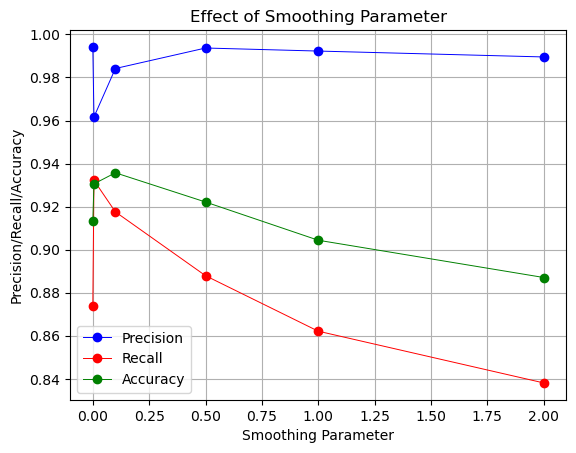

In [76]:
val_lambda = [0,0.005,0.1,0.5,1.0,2.0]
val_precision = [precision_00, precision_0005, precision_01, precision_05, precision_10, precision_20]
val_recall = [recall_00, recall_0005, recall_01, recall_05, recall_10, recall_20]
val_accuracy = [accuracy_00, accuracy_0005, accuracy_01, accuracy_05, accuracy_10, accuracy_20]

plt.plot(val_lambda, val_precision, '-b', label ='Precision', marker='o', linewidth = 0.7) 
plt.plot(val_lambda, val_recall, '-r', label ='Recall', marker='o', linewidth = 0.7) 
plt.plot(val_lambda, val_accuracy, '-g', label ='Accuracy', marker='o', linewidth = 0.7) 
plt.xlim(-0.1, 2.1)
plt.legend()
plt.xlabel("Smoothing Parameter")
plt.ylabel("Precision/Recall/Accuracy")
plt.title("Effect of Smoothing Parameter")
plt.grid(True)
plt.show() 

### Feature Selection: Mutual Information

In [43]:
def mutual_information(df_train, dict_prior_prb, tot=200):

    '''Prior Probabilities'''
    prior_spam = dict_prior_prb['prior_spam']
    prior_ham = dict_prior_prb['prior_ham']
    spm_data = {'spam': [True, False],
                'p_c': [prior_spam, prior_ham]}
    df_train_mi_spm = pd.DataFrame(spm_data)
        
    '''Calculations'''
    df_train_mi_cnt = df_train['id'].nunique() # count of documents
    
    df_train_mi = df_train.groupby(['spam','file_data']).size().reset_index(name='count') # count of a specific word per class
    df_train_mi['p_xc'] = df_train_mi['count'].div(df_train_mi_cnt) # (count of a specific word per class) / (count of documents)
    df_train_mi = df_train_mi.drop('count', axis=1)
    
    df_train_mi_wrd = df_train.groupby(['file_data']).size().reset_index(name='count') # count of a specific word
    df_train_mi_wrd['p_x'] = df_train_mi_wrd['count'].div(df_train_mi_cnt) # (count of a specific word) / (count of documents)
    df_train_mi_wrd = df_train_mi_wrd.drop('count', axis=1)
    
    df_train_mi = pd.merge(df_train_mi, df_train_mi_wrd, on='file_data')
    df_train_mi = pd.merge(df_train_mi, df_train_mi_spm, on='spam')
    
    '''Main Formula'''
    df_train_mi['mi'] =  df_train_mi['p_xc'] * np.log(df_train_mi['p_xc'] / (df_train_mi['p_x'] * df_train_mi['p_c']))
    df_train_mi = df_train_mi.groupby(['file_data'])['mi'].sum().reset_index()
    df_train_mi = df_train_mi.sort_values('mi', ascending=False) 
    
    df_train_mi = df_train_mi.head(tot)
    
    return df_train_mi

In [44]:
df_mi = mutual_information(df_train, dict_prior_prb)
print('Top 200 Words')
print(df_mi)

Top 200 Words
         file_data        mi
39259         list  0.124773
32131            i  0.092642
65196       thanks  0.063176
68689          use  0.062730
68180   university  0.055380
32532           if  0.055148
29959   handyboard  0.047976
71957        would  0.047172
42746         mime  0.046898
4964        anyone  0.046457
65303        there  0.045617
20167         dmdx  0.043772
20261         does  0.043270
44466           my  0.042714
4100            am  0.042675
26300       format  0.042073
52200      problem  0.041162
47254           on  0.040867
10855          but  0.039774
5876         ascii  0.039689
56209       ribbon  0.038287
25409         file  0.036829
69467      version  0.035706
65208         that  0.035427
37102         know  0.034597
60769           so  0.034312
30350           hb  0.034113
29954        handy  0.033870
35081           it  0.033637
47989          our  0.033584
57188      running  0.033306
4405            an  0.032720
47524          opt  0.032307


In [45]:
set_voc_200 = set(df_mi['file_data'])

In [47]:
'''Varying Lambda, Same Prior Probabilities, Same Vocabulary of Top 200 MI Words'''
l = 0.0
dict_train_spam_00_mi, dict_train_ham_00_mi, spam_zero_00_mi, ham_zero_00_mi = naive_bayes_input(df_train, set_voc_200, dict_prior_prb, lambda_=l)
l = 2.0
dict_train_spam_20_mi, dict_train_ham_20_mi, spam_zero_20_mi, ham_zero_20_mi = naive_bayes_input(df_train, set_voc_200, dict_prior_prb, lambda_=l)
l = 1.0
dict_train_spam_10_mi, dict_train_ham_10_mi, spam_zero_10_mi, ham_zero_10_mi = naive_bayes_input(df_train, set_voc_200, dict_prior_prb, lambda_=l)
l = 0.5
dict_train_spam_05_mi, dict_train_ham_05_mi, spam_zero_05_mi, ham_zero_05_mi = naive_bayes_input(df_train, set_voc_200, dict_prior_prb, lambda_=l)
l = 0.1
dict_train_spam_01_mi, dict_train_ham_01_mi, spam_zero_01_mi, ham_zero_01_mi = naive_bayes_input(df_train, set_voc_200, dict_prior_prb, lambda_=l)
l = 0.005
dict_train_spam_0005_mi, dict_train_ham_0005_mi, spam_zero_0005_mi, ham_zero_0005_mi = naive_bayes_input(df_train, set_voc_200, dict_prior_prb, lambda_=l)

In [48]:
print('LAMBDA = 0.0, SPAM DICTIONARY')
print(dict_train_spam_00_mi)

LAMBDA = 0.0, SPAM DICTIONARY
{'to': 0.569368531224561, 'the': 0.5143621351319921, 'and': 0.503895801837423, 'of': 0.45266891499011513, 'our': 0.3735899523200372, 'format': 0.36876380974531925, 'mime': 0.36864751715315736, 'microsoft': 0.3572508431212932, 'outlook': 0.27846261193162, 'it': 0.26904291196650776, 'that': 0.26212350273287593, 'on': 0.26113501569949993, 'be': 0.2471217583439935, 'have': 0.24601697871845563, 'mimeole': 0.242760786137923, 'or': 0.24008605651819978, 'express': 0.2336318176532155, 'are': 0.23113152692173508, 'not': 0.21455983253866728, 'public': 0.20170950110477961, 'info': 0.19647633445749504, 'website': 0.1836260030236074, 'can': 0.1651354808698686, 'i': 0.16106524014420281, 'as': 0.1569368531224561, 'any': 0.14309803465519247, 'allowed': 0.13966740318641702, 'but': 0.13926037911385045, 'sender': 0.1330387254331899, 'v': 0.13245726247238052, 'one': 0.13175950691940924, 't': 0.12896848470752412, 'an': 0.1285033143388766, 'apache': 0.1274566810094197, 'do': 0.1

In [49]:
print('LAMBDA = 0.0, HAM DICTIONARY')
print(dict_train_ham_00_mi)

LAMBDA = 0.0, HAM DICTIONARY
{'the': 0.9212988442487617, 'to': 0.882883874518437, 'and': 0.7950467804072647, 'of': 0.7897633461750138, 'i': 0.7167859108420473, 'on': 0.6512933406714364, 'that': 0.6204733076499724, 'it': 0.6200330214639516, 'be': 0.5674188222344524, 'have': 0.5620253164556962, 'if': 0.47385800770500824, 'are': 0.46505228398459, 'not': 0.4561364887176665, 'can': 0.44479911942762795, 'but': 0.44204733076499725, 'or': 0.4317006053935058, 'list': 0.41386901485965877, 'as': 0.4130985140341222, 'an': 0.38822234452394055, 'any': 0.35443037974683544, 'my': 0.33241607044578975, 'there': 0.3229499174463401, 'use': 0.31986791414419374, 'do': 0.31073197578425976, 'so': 0.3039075399009356, 'would': 0.3023665382498624, 'mail': 0.29521188772702256, 'one': 0.29510181618051734, 'some': 0.2783709411117226, 'get': 0.2759493670886076, 'when': 0.2735277930654926, 'what': 0.27121629058888275, 'about': 0.26108970831040174, 'am': 0.2585580627407815, 'was': 0.25679691799669785, 'like': 0.256356

In [50]:
l = 0.0
df_predict_00_mi = df_test['file_data'].apply(lambda t: naive_bayes_classifier(t, 
                                                                            dict_train_spam_00_mi, dict_train_ham_00, 
                                                                            spam_zero_00_mi, ham_zero_00_mi,
                                                                            prior_spam, prior_ham, 
                                                                            set_voc_200, lambda_=l))

In [51]:
l = 0.005
df_predict_0005_mi = df_test['file_data'].apply(lambda t: naive_bayes_classifier(t, 
                                                                            dict_train_spam_0005_mi, dict_train_ham_0005_mi, 
                                                                            spam_zero_0005_mi, ham_zero_0005_mi, 
                                                                            prior_spam, prior_ham, 
                                                                            set_voc_200, lambda_=l))

In [52]:
l = 0.1
df_predict_01_mi = df_test['file_data'].apply(lambda t: naive_bayes_classifier(t, 
                                                                            dict_train_spam_01_mi, dict_train_ham_01_mi, 
                                                                            spam_zero_01_mi, ham_zero_01_mi, 
                                                                            prior_spam, prior_ham, 
                                                                            set_voc_200, lambda_=l))

In [53]:
l = 0.5
df_predict_05_mi = df_test['file_data'].apply(lambda t: naive_bayes_classifier(t, 
                                                                            dict_train_spam_05_mi, dict_train_ham_05_mi, 
                                                                            spam_zero_05_mi, ham_zero_05_mi, 
                                                                            prior_spam, prior_ham, 
                                                                            set_voc_200, lambda_=l))

In [54]:
l = 1.0
df_predict_10_mi = df_test['file_data'].apply(lambda t: naive_bayes_classifier(t, 
                                                                            dict_train_spam_10_mi, dict_train_ham_10_mi, 
                                                                            spam_zero_10_mi, ham_zero_10_mi, 
                                                                            prior_spam, prior_ham, 
                                                                            set_voc_200, lambda_=l))

In [55]:
l = 2.0
df_predict_20_mi = df_test['file_data'].apply(lambda t: naive_bayes_classifier(t, 
                                                                            dict_train_spam_20_mi, dict_train_ham_20_mi, 
                                                                            spam_zero_20_mi, ham_zero_20_mi, 
                                                                            prior_spam, prior_ham, 
                                                                            set_voc_200, lambda_=l))

In [56]:
print('lambda = 0.0')
accuracy_00_mi, precision_00_mi, recall_00_mi = measures(df_predict_00_mi, df_test['spam'], to_print = True)
print('lambda = 2.0')
accuracy_20_mi, precision_20_mi, recall_20_mi = measures(df_predict_20_mi, df_test['spam'], to_print = True)
print('lambda = 1.0')
accuracy_10_mi, precision_10_mi, recall_10_mi = measures(df_predict_10_mi, df_test['spam'], to_print = True)
print('lambda = 0.5')
accuracy_05_mi, precision_05_mi, recall_05_mi = measures(df_predict_05_mi, df_test['spam'], to_print = True)
print('lambda = 0.1')
accuracy_01_mi, precision_01_mi, recall_01_mi = measures(df_predict_01_mi, df_test['spam'], to_print = True)
print('lambda = 0.005')
accuracy_0005_mi, precision_0005_mi, recall_0005_mi = measures(df_predict_0005_mi, df_test['spam'], to_print = True)

lambda = 0.0
Accuracy: 0.3386896306818182
Precision: nan
Recall: 0.0


lambda = 2.0
Accuracy: 0.6417791193181818
Precision: 0.9648692810457516
Recall: 0.47563431333064843


lambda = 1.0
Accuracy: 0.6431995738636364
Precision: 0.9632631010264722
Recall: 0.47872197610417505


lambda = 0.5
Accuracy: 0.6436434659090909
Precision: 0.9630628201671609
Recall: 0.47952745334944286


lambda = 0.1
Accuracy: 0.6404474431818182
Precision: 0.9621974435681262
Recall: 0.4749630822929252


lambda = 0.005
Accuracy: 0.6048473011363636
Precision: 0.9586903304773562
Recall: 0.4205933682373473




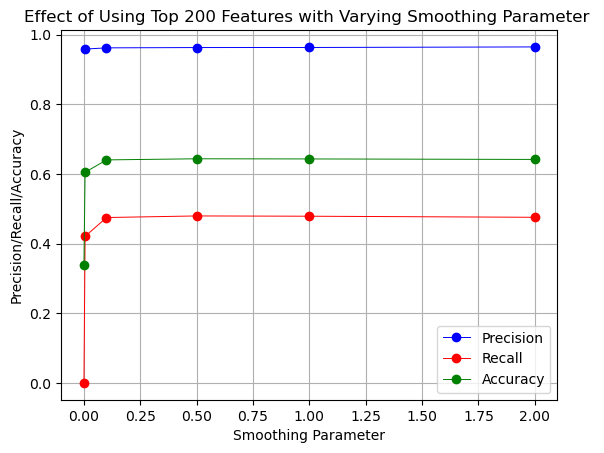

In [74]:
val_lambda = [0,0.005,0.1,0.5,1.0,2.0]
val_precision_mi = [precision_00_mi, precision_0005_mi, precision_01_mi, precision_05_mi, precision_10_mi, precision_20_mi]
val_recall_mi = [recall_00_mi, recall_0005_mi, recall_01_mi, recall_05_mi, recall_10_mi, recall_20_mi]
val_accuracy_mi = [accuracy_00_mi, accuracy_0005_mi, accuracy_01_mi, accuracy_05_mi, accuracy_10_mi, accuracy_20_mi]

plt.plot(val_lambda, val_precision_mi, '-b', label ='Precision', marker='o', linewidth = 0.7) 
plt.plot(val_lambda, val_recall_mi, '-r', label ='Recall', marker='o', linewidth = 0.7) 
plt.plot(val_lambda, val_accuracy_mi, '-g', label ='Accuracy', marker='o', linewidth = 0.7) 
plt.xlim(-0.1, 2.1)
plt.legend()
plt.xlabel("Smoothing Parameter")
plt.ylabel("Precision/Recall/Accuracy")
plt.title("Effect of Using Top 200 Features with Varying Smoothing Parameter ")
plt.grid(True)
plt.show() 

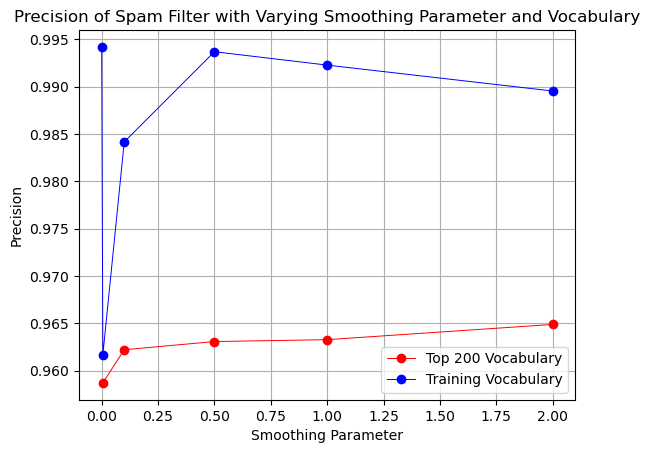

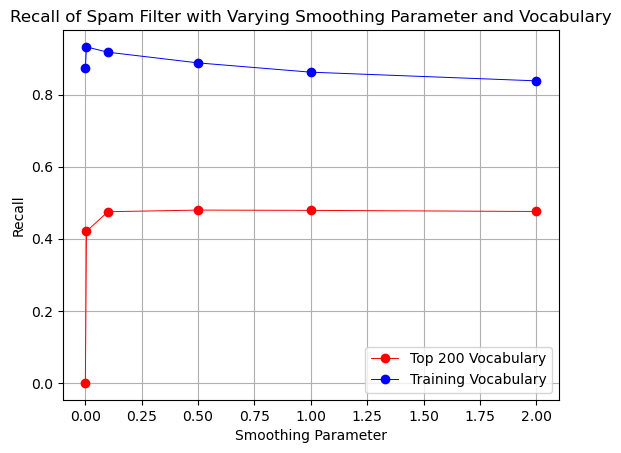

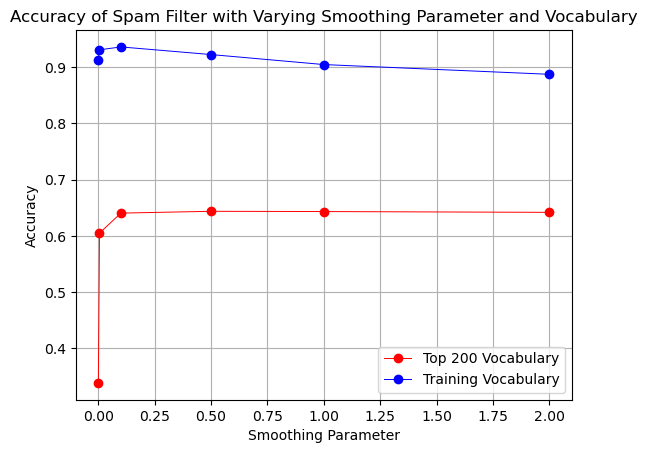

In [73]:
val_lambda = [0,0.005,0.1,0.5,1.0,2.0]
val_precision_mi = [precision_00_mi, precision_0005_mi, precision_01_mi, precision_05_mi, precision_10_mi, precision_20_mi]
val_recall_mi = [recall_00_mi, recall_0005_mi, recall_01_mi, recall_05_mi, recall_10_mi, recall_20_mi]
val_accuracy_mi = [accuracy_00_mi, accuracy_0005_mi, accuracy_01_mi, accuracy_05_mi, accuracy_10_mi, accuracy_20_mi]
val_precision = [precision_00, precision_0005, precision_01, precision_05, precision_10, precision_20]
val_recall = [recall_00, recall_0005, recall_01, recall_05, recall_10, recall_20]
val_accuracy = [accuracy_00, accuracy_0005, accuracy_01, accuracy_05, accuracy_10, accuracy_20]

plt.plot(val_lambda, val_precision_mi, '-r', label ='Top 200 Vocabulary', marker='o', linewidth = 0.7) 
plt.plot(val_lambda, val_precision, '-b', label ='Training Vocabulary', marker='o', linewidth = 0.7) 
plt.xlim(-0.1, 2.1)
plt.legend()
plt.xlabel("Smoothing Parameter")
plt.ylabel("Precision")
plt.title("Precision of Spam Filter with Varying Smoothing Parameter and Vocabulary")
plt.grid(True)
plt.show() 


plt.plot(val_lambda, val_recall_mi, '-r', label ='Top 200 Vocabulary', marker='o', linewidth = 0.7) 
plt.plot(val_lambda, val_recall, '-b', label ='Training Vocabulary', marker='o', linewidth = 0.7) 
plt.xlim(-0.1, 2.1)
plt.legend()
plt.xlabel("Smoothing Parameter")
plt.ylabel("Recall")
plt.title("Recall of Spam Filter with Varying Smoothing Parameter and Vocabulary")
plt.grid(True)
plt.show() 

plt.plot(val_lambda, val_accuracy_mi, '-r', label ='Top 200 Vocabulary', marker='o', linewidth = 0.7) 
plt.plot(val_lambda, val_accuracy, '-b', label ='Training Vocabulary', marker='o', linewidth = 0.7) 
plt.xlim(-0.1, 2.1)
plt.legend()
plt.xlabel("Smoothing Parameter")
plt.ylabel("Accuracy")
plt.title("Accuracy of Spam Filter with Varying Smoothing Parameter and Vocabulary")
plt.grid(True)
plt.show() 

In [65]:
rank_mi_10 = []
accuracy_mi_10 = []
precision_mi_10 = []
recall_mi_10 = []

for i in range(0,10000,500):
    df_mi = mutual_information(df_train, dict_prior_prb, tot=i)
    set_voc_mi = set(df_mi['file_data'])
    l = 1.0
    dict_train_spam_mi, dict_train_ham_mi, spam_zero_mi, ham_zero_mi = naive_bayes_input(df_train, set_voc_mi, dict_prior_prb, lambda_=l)
    df_predict_mi = df_test['file_data'].apply(lambda t: naive_bayes_classifier(t, 
                                                                            dict_train_spam_mi, dict_train_ham_mi, 
                                                                            spam_zero_mi, ham_zero_mi, 
                                                                            prior_spam, prior_ham, 
                                                                            set_voc_mi, lambda_=l))
    accuracy_mi, precision_mi, recall_mi = measures(df_predict_mi, df_test['spam'])
    accuracy_mi_10.append(accuracy_mi)
    precision_mi_10.append(precision_mi)
    recall_mi_10.append(recall_mi)
    rank_mi_10.append(i)

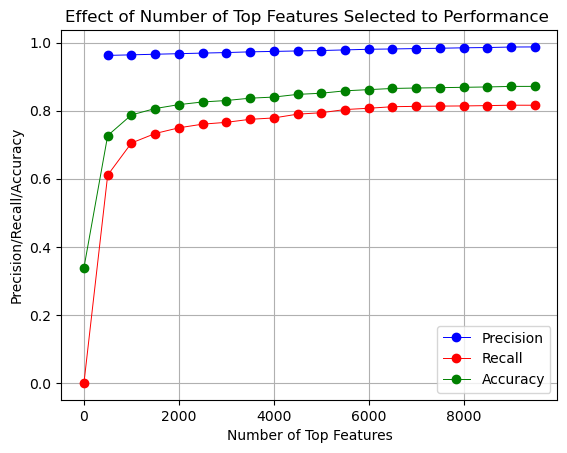

In [72]:
plt.plot(rank_mi_10, precision_mi_10 , '-b', label ='Precision', marker='o', linewidth = 0.7) 
plt.plot(rank_mi_10, recall_mi_10, '-r', label ='Recall', marker='o', linewidth = 0.7) 
plt.plot(rank_mi_10, accuracy_mi_10, '-g', label ='Accuracy', marker='o', linewidth = 0.7) 
plt.legend()
plt.xlabel("Number of Top Features")
plt.ylabel("Precision/Recall/Accuracy")
plt.title("Effect of Number of Top Features Selected to Performance ")
plt.grid(True)
plt.show() 

In [71]:
for i in range(len(rank_mi_10)):
    print(f'No of Top Features: {rank_mi_10[i]}')
    print(f'Accuracy: {accuracy_mi_10[i]}')
    print(f'Precision: {precision_mi_10[i]}')
    print(f'Recall: {recall_mi_10[i]} \n')


No of Top Features: 0
Accuracy: 0.3386896306818182
Precision: nan
Recall: 0.0 

No of Top Features: 500
Accuracy: 0.7268288352272727
Precision: 0.9625476089716463
Recall: 0.6106859981205531 

No of Top Features: 1000
Accuracy: 0.7876420454545454
Precision: 0.964200477326969
Recall: 0.7050610820244329 

No of Top Features: 1500
Accuracy: 0.8063742897727273
Precision: 0.9660297239915074
Recall: 0.7329842931937173 

No of Top Features: 2000
Accuracy: 0.8179154829545454
Precision: 0.9676022176022177
Recall: 0.7497650691367969 

No of Top Features: 2500
Accuracy: 0.8257279829545454
Precision: 0.9693702943189596
Recall: 0.7605047657403678 

No of Top Features: 3000
Accuracy: 0.8299893465909091
Precision: 0.9708985704560926
Recall: 0.7658746140421533 

No of Top Features: 3500
Accuracy: 0.8368252840909091
Precision: 0.9730230989715056
Recall: 0.7747348637400994 

No of Top Features: 4000
Accuracy: 0.8401100852272727
Precision: 0.9743029895868324
Recall: 0.7787622499664385 

No of Top Features